### CellStitch figures, benchmark & robustness analysis

In [1]:
%gui qt

In [ ]:
from mayavi import mlab
mlab.init_notebook()

In [1]:
import os
import sys
import gc
import h5py
import napari
import numpy as np
import pandas as pd

from skimage.color import label2rgb

/home/yinuo/anaconda3/lib/python3.8/site-packages/requests/__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.16) or chardet (5.1.0)/charset_normalizer (2.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({})/charset_normalizer ({}) doesn't match a supported "


In [2]:
sys.path.append('..')

In [3]:
from cellpose import utils as cp_utils
from cellpose import plot as cp_plot
from cellpose import models as cp_models

from cellstitch.pipeline import full_stitch
from cellstitch.interpolate import full_interpolate
from cellstitch import utils as ct_utils
from cellstitch import evaluation

In [4]:
from importlib import reload
reload(evaluation)

<module 'cellstitch.evaluation' from '../cellstitch/evaluation.py'>

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.font_manager

from IPython.display import display
from matplotlib import rcParams

sns.set_style('white')

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'

rcParams['font.family'] = plot_font
rcParams.update({'font.size': 15})

params = {'mathtext.default': 'regular'}
plt.rcParams.update(params)

In [4]:
cp_model = cp_models.Cellpose(gpu=True, model_type='cyto2')

cell depths in each dataset:

In [27]:
imgs = [
    np.load(os.path.join('../results/Anther/cellstitch', f)) 
    for f in os.listdir('../results/Anther/cellstitch')
    if f[-3:] == 'npy'
]

In [24]:
avg_Z = np.mean([img.shape[0] for img in imgs])
avg_Y = np.mean([img.shape[1] for img in imgs])
avg_X = np.mean([img.shape[2] for img in imgs])
print(avg_Z, avg_Y, avg_X)

20.0 224.0 224.0


#### Stitching performance vs. Cellpose2D

- replace Cellpose (best) w/ Cellpose (avg)
- Remove Relative errors, add precision, recall & F1

Load data

In [11]:
%ls ../results/ovules/stitching/

cp.csv  cte.csv        ct_rev.csv        ct_stitched/
ct.csv  cte_stitched/  ct_rev_stitched/  unstitched/


In [14]:
stitch_path = '../results/ovules/stitching/'

cp_metrics_df = pd.read_csv(os.path.join(stitch_path, 'cp.csv'), index_col=[0])
ct_euc_metrics_df = pd.read_csv(os.path.join(stitch_path, 'cte.csv'), index_col=[0])
ct_metrics_df = pd.read_csv(os.path.join(stitch_path, 'ct.csv'), index_col=[0])
ct_rev_metrics_df = pd.read_csv(os.path.join(stitch_path, 'ct_rev.csv'), index_col=[0])


In [31]:
def calc_prec_recall_f1(df):
    prec = df.apply(lambda x: x['tp'] / (x['tp'] + x['fp']), axis=1)
    recall = df.apply(lambda x: x['tp'] / (x['tp'] + x['rn']), axis=1)
    f1 = df.apply(lambda x: x['tp'] / (x['tp'] + 0.5*(x['fp'] + x['rn'])), axis=1)
    df['prec'], df['recall'], df['f1'] = prec, recall, f1
    return None

In [32]:
calc_prec_recall_f1(cp_metrics_df)
calc_prec_recall_f1(ct_euc_metrics_df)
calc_prec_recall_f1(ct_metrics_df)
calc_prec_recall_f1(ct_rev_metrics_df)


In [43]:
# Get average Cellpose metrics across thresholds
cp_avg_metrics_df = cp_metrics_df.groupby('filename').mean()

Plotting:

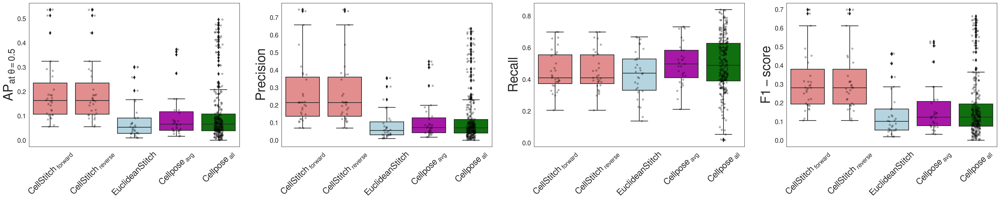

In [88]:
n_samples = ct_metrics_df.shape[0]

aps_df = pd.DataFrame({
    'AP': ct_metrics_df['ap'].to_list() + ct_rev_metrics_df['ap'].to_list() + ct_euc_metrics_df['ap'].to_list() + cp_avg_metrics_df['ap'].to_list() + cp_metrics_df['ap'].to_list(),
    'Method': n_samples*['ct'] + n_samples*['ct_rev'] + n_samples*['ct_euc'] + n_samples*['cp_avg'] + len(cp_metrics_df)*['cp']
})

precs_df = pd.DataFrame({
    'Prec': ct_metrics_df['prec'].to_list() + ct_rev_metrics_df['prec'].to_list() + ct_euc_metrics_df['prec'].to_list() + cp_avg_metrics_df['prec'].to_list() + cp_metrics_df['prec'].to_list(),
    'Method': n_samples*['ct'] + n_samples*['ct_rev'] + n_samples*['ct_euc'] + n_samples*['cp_avg'] + len(cp_metrics_df)*['cp']
})

recalls_df = pd.DataFrame({
    'Recall': ct_metrics_df['recall'].to_list() + ct_rev_metrics_df['recall'].to_list() + ct_euc_metrics_df['recall'].to_list() + cp_avg_metrics_df['recall'].to_list() + cp_metrics_df['recall'].to_list(),
    'Method': n_samples*['ct'] + n_samples*['ct_rev'] + n_samples*['ct_euc'] + n_samples*['cp_avg'] + len(cp_metrics_df)*['cp']
})

f1s_df = pd.DataFrame({
    'F1': ct_metrics_df['f1'].to_list() + ct_rev_metrics_df['f1'].to_list() + ct_euc_metrics_df['f1'].to_list() + cp_avg_metrics_df['f1'].to_list() + cp_metrics_df['f1'].to_list(),
    'Method': n_samples*['ct'] + n_samples*['ct_rev'] + n_samples*['ct_euc'] + n_samples*['cp_avg'] + len(cp_metrics_df)*['cp']
})

fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(40, 6), dpi=300)

xticklabels = [r'$CellStitch_{\ forward}$', r'$CellStitch_{\ reverse}$', 'EuclideanStitch', r'$Cellpose_{\ avg}$', r'$Cellpose_{\ all}$']
my_pal = {
    'ct': 'lightcoral',
    'ct_rev': 'lightcoral',
    'ct_euc': 'lightblue',
    'cp_avg': 'm',
    'cp': 'green'
}

ax1 = sns.boxplot(data=aps_df, x='Method', y='AP', palette=my_pal, ax=ax1)
sns.stripplot(data=aps_df, x='Method', y='AP', color='k', alpha=0.3, dodge=True, ax=ax1)
ax1.set_xticks([0, 1, 2, 3, 4])
ax1.set_xticklabels(xticklabels, rotation=45, fontsize=20)  
ax1.set_ylabel(r'$AP_{at\ \theta=0.5}$', fontsize=30)
ax1.set(xlabel=None)

ax2 = sns.boxplot(data=precs_df, x='Method', y='Prec', palette=my_pal, ax=ax2)
sns.stripplot(data=precs_df, x='Method', y='Prec', color='k', alpha=0.3, dodge=True, ax=ax2)
ax2.set_xticks([0, 1, 2, 3, 4])
ax2.set_xticklabels(xticklabels, rotation=45, fontsize=20)  
ax2.set_ylabel(r'$Precision$', fontsize=30)
ax2.set(xlabel=None)

ax3 = sns.boxplot(data=recalls_df, x='Method', y='Recall', palette=my_pal, ax=ax3)
sns.stripplot(data=recalls_df, x='Method', y='Recall', color='k', alpha=0.3, dodge=True, ax=ax3)
ax3.set_xticks([0, 1, 2, 3, 4])
ax3.set_xticklabels(xticklabels, rotation=45, fontsize=20)  
ax3.set_ylabel(r'$Recall$', fontsize=30)
ax3.set(xlabel=None)

ax4 = sns.boxplot(data=f1s_df, x='Method', y='F1', palette=my_pal, ax=ax4)
sns.stripplot(data=f1s_df, x='Method', y='F1', color='k', alpha=0.3, dodge=True, ax=ax4)
ax4.set_xticks([0, 1, 2, 3, 4])
ax4.set_xticklabels(xticklabels, rotation=45, fontsize=20)  
ax4.set_ylabel(r'$F1-score$', fontsize=30)
ax4.set(xlabel=None)

plt.savefig('../figures/fig4_stitching.png', dpi=300, bbox_inches='tight')
plt.show()

In [89]:
del aps_df, precs_df, recalls_df, f1s_df

#### Table 2.

In [7]:
# Evaluate VOI (archived)

mask_path = '../data/ovules/test/'

fnames = [
    f.rpartition('.')[0]
    for f in sorted(os.listdir(mask_path))
]

masks = [
    h5py.File(os.path.join(mask_path, f))['label'][:]
    for f in sorted(os.listdir(mask_path))
    if f[-2:] == 'h5'
]

low_anis_path = '../results/ovules/'
ct_preds = [
    np.load(os.path.join(low_anis_path, 'cellstitch', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(low_anis_path, 'cellstitch')))
    if f[-3:] == 'npy'
]

cp2d_preds = [
    np.load(os.path.join(low_anis_path, 'cellpose2d', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(low_anis_path, 'cellpose3d')))
    if f[-3:] == 'npy'
]

cp3d_preds = [
    np.load(os.path.join(low_anis_path, 'cellpose3d', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(low_anis_path, 'cellpose3d')))
    if f[-3:] == 'npy'
]

ps_preds = [
    np.load(os.path.join(low_anis_path, 'plantseg', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(low_anis_path, 'plantseg')))
    if f[-3:] == 'npy'
]


In [10]:
vi_ct = {'h_over': [], 'h_under': []}
vi_cp2d = {'h_over': [], 'h_under': []}
vi_cp3d = {'h_over': [], 'h_under': []}
vi_ps = {'h_over': [], 'h_under': []}

for (mask, pred) in zip(masks, ct_preds):
    vi0, vi1 = variation_of_information(mask, pred, ignore_labels=[0])
    vi_ct['h_over'].append(vi0)
    vi_ct['h_under'].append(vi1)
    
for (mask, pred) in zip(masks, cp2d_preds):
    vi0, vi1 = variation_of_information(mask, pred, ignore_labels=[0])
    vi_cp2d['h_over'].append(vi0)
    vi_cp2d['h_under'].append(vi1)
    
for (mask, pred) in zip(masks, cp3d_preds):
    vi0, vi1 = variation_of_information(mask, pred, ignore_labels=[0])
    vi_cp3d['h_over'].append(vi0)
    vi_cp3d['h_under'].append(vi1)
    
for (mask, pred) in zip(masks, ps_preds):
    vi0, vi1 = variation_of_information(mask, pred, ignore_labels=[0])
    vi_ps['h_over'].append(vi0)
    vi_ps['h_under'].append(vi1)
    
del mask, pred, vi0, vi1

vi_df = pd.DataFrame({
    'ct_over':    vi_ct['h_over'],
    'ct_under':   vi_ct['h_under'],
    'cp2d_over':  vi_cp2d['h_over'],
    'cp2d_under': vi_cp2d['h_under'],
    'cp3d_over':  vi_cp3d['h_over'],
    'cp3d_under': vi_cp3d['h_under'],
    'ps_over':    vi_ps['h_over'],
    'ps_under':   vi_ps['h_under']
})
vi_df.index = fnames
display(vi_df)

print('Mean:')
display(vi_df.mean(0).apply(lambda x: np.round(x, 2)))
print('\n\nStd:')
display(vi_df.std(0).apply(lambda x: np.round(x, 2)))

# Save results to output
vi_df.to_csv(os.path.join(low_anis_path, 'VoI.csv'), index=True)

In [14]:
high_anis_path = '../results/ovules_subsampled/'

ct_preds = [
    np.load(os.path.join(high_anis_path, 'cellstitch', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(high_anis_path, 'cellstitch')))
    if f[-3:] == 'npy'
]

cp2d_preds = [
    np.load(os.path.join(high_anis_path, 'cellpose2d', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(high_anis_path, 'cellpose3d')))
    if f[-3:] == 'npy'
]

cp3d_preds = [
    np.load(os.path.join(high_anis_path, 'cellpose3d', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(high_anis_path, 'cellpose3d')))
    if f[-3:] == 'npy'
]

ps_preds = [
    np.load(os.path.join(high_anis_path, 'plantseg', f)).astype(np.int32)
    for f in sorted(os.listdir(os.path.join(high_anis_path, 'plantseg')))
    if f[-3:] == 'npy'
]

vi_ct = {'h_over': [], 'h_under': []}
vi_cp2d = {'h_over': [], 'h_under': []}
vi_cp3d = {'h_over': [], 'h_under': []}
vi_ps = {'h_over': [], 'h_under': []}

for (mask, pred) in zip(masks, ct_preds):
    slc_indices = np.arange(0, mask.shape[0], 2)
    vi0, vi1 = variation_of_information(mask[slc_indices], pred, ignore_labels=[0])
    vi_ct['h_over'].append(vi0)
    vi_ct['h_under'].append(vi1)
    
for (mask, pred) in zip(masks, cp2d_preds):
    slc_indices = np.arange(0, mask.shape[0], 2)
    vi0, vi1 = variation_of_information(mask[slc_indices], pred, ignore_labels=[0])
    vi_cp2d['h_over'].append(vi0)
    vi_cp2d['h_under'].append(vi1)
    
for (mask, pred) in zip(masks, cp3d_preds):
    slc_indices = np.arange(0, mask.shape[0], 2)
    vi0, vi1 = variation_of_information(mask[slc_indices], pred, ignore_labels=[0])
    vi_cp3d['h_over'].append(vi0)
    vi_cp3d['h_under'].append(vi1)
    
for (mask, pred) in zip(masks, ps_preds):
    slc_indices = np.arange(0, mask.shape[0], 2)
    vi0, vi1 = variation_of_information(mask[slc_indices], pred, ignore_labels=[0])
    vi_ps['h_over'].append(vi0)
    vi_ps['h_under'].append(vi1)
    
del mask, pred, vi0, vi1, slc_indices

vi_df = pd.DataFrame({
    'ct_over':    vi_ct['h_over'],
    'ct_under':   vi_ct['h_under'],
    'cp2d_over':  vi_cp2d['h_over'],
    'cp2d_under': vi_cp2d['h_under'],
    'cp3d_over':  vi_cp3d['h_over'],
    'cp3d_under': vi_cp3d['h_under'],
    'ps_over':    vi_ps['h_over'],
    'ps_under':   vi_ps['h_under']
})
vi_df.index = fnames
display(vi_df)

# vi_df = pd.read_csv(os.path.join(high_anis_path, 'VoI_high_anis.csv'), index_col=0)
print('Mean:')
display(vi_df.mean(0).apply(lambda x: np.round(x, 2)))
print('\n\nStd:')
display(vi_df.std(0).apply(lambda x: np.round(x, 2)))

# Save results to output
vi_df.to_csv(os.path.join(high_anis_path, 'VoI_high_anis.csv'), index=True)

##### Completion of CellStitch (interp) (Low-anisotropy img from high-anisotropy img)

In [105]:
low_anis_path = '../results/ovules/pipeline/cellstitch/'
high_anis_path = '../results/ovules_subsampled/pipeline/cellstitch/'

In [106]:
sample_low_anis_msk = np.load(os.path.join(low_anis_path, 'N_294_final_crop_ds2.npy'))
sample_high_anis_msk = np.load(os.path.join(high_anis_path, 'N_294_final_crop_ds2.npy'))

In [ ]:
high_anis_preds = [
    np.load(os.path.join(high_anis_path, f)).astype(np.int32)
    for f in sorted(os.listdir(high_anis_path))
    if f[-3:] == 'npy'
]

low_anis_interp_preds = []

for high_anis_pred in high_anis_preds:
    interp_pred = full_interpolate(high_anis_pred)
    low_anis_interp_preds.append(interp_pred)

In [14]:
mask_fnames = [f for f in sorted(os.listdir(high_anis_path)) if f[-3:] == 'npy']

for i, pred in enumerate(low_anis_interp_preds):
    fname = mask_fnames[i][:-4] + '_interp.npy'
    np.save(os.path.join(low_anis_path, fname), pred)
                         
del fname

Benchmark interpolated low-anis with ground-truth:

In [15]:
# Load GT masks
mask_path = '../data/ovules/masks'
mask_fnames = [f for f in sorted(os.listdir(high_anis_path)) if f[-3:] == 'npy']

masks = [
    np.load(os.path.join(mask_path, f)).astype(np.int32)
    for f in mask_fnames
]

In [29]:
interp_metrics = np.zeros((len(low_anis_interp_preds), 4))

for i, (y_true, y_pred) in enumerate(zip(masks, low_anis_interp_preds)):
    # interpretation predictions will have depth = depth(mask)-1
    # compare the first (z-1) layers
    y_pred = y_pred.astype(np.int64)
    y_true_ = y_true[:y_pred.shape[0], :, :]
    ap, tp, fp, fn = evaluation.average_precision(y_true_, y_pred, 0.5)
    prec, recall, f1 = tp/(tp+fp), tp/(tp+fn), tp/(tp+0.5*(fp+fn))
    
    interp_metrics[i] = [ap, prec, recall, f1]
    
del y_true_, y_pred, ap, tp, fp, fn, prec, recall, f1

interp_metrics_df = pd.DataFrame(interp_metrics, index=mask_fnames, columns=['ap', 'prec', 'recall', 'f1'])
interp_metrics_df.head()

/home/yinuo/anaconda3/lib/python3.8/site-packages/cellpose/metrics.py:205: RuntimeWarning: invalid value encountered in divide
  iou = overlap / (n_pixels_pred + n_pixels_true - overlap)


,ap,prec,recall,f1
N_294_final_crop_ds2.npy,0.394972,0.688691,0.480816,0.566279
N_435_final_crop_ds2.npy,0.421743,0.655977,0.541516,0.593276
N_441_final_crop_ds2.npy,0.413583,0.576806,0.593750,0.585156
N_511_final_crop_ds2.npy,0.529153,0.778947,0.622654,0.692086
N_522_final_crop_ds2.npy,0.484694,0.695971,0.614887,0.652921


In [30]:
interp_metrics_df

,ap,prec,recall,f1
N_294_final_crop_ds2.npy,0.394972,0.688691,0.480816,0.566279
N_435_final_crop_ds2.npy,0.421743,0.655977,0.541516,0.593276
N_441_final_crop_ds2.npy,0.413583,0.576806,0.593750,0.585156
N_511_final_crop_ds2.npy,0.529153,0.778947,0.622654,0.692086
N_522_final_crop_ds2.npy,0.484694,0.695971,0.614887,0.652921
N_590_final_crop_ds2.npy,0.304379,0.634731,0.369017,0.466703
N_593_final_crop_ds2.npy,0.310918,0.577093,0.402664,0.474351


In [49]:
interp_metrics_df.apply(lambda x: r'{0} ({1})'.format(np.round(x.mean(), 2), np.round(x.std(), 2)), axis=0)

ap        0.41 (0.08)
prec      0.66 (0.07)
recall     0.52 (0.1)
f1        0.58 (0.08)
dtype: object

In [ ]:
interp_metrics_df.to_csv(os.path.join('../results/ovules/pipeline/', 'cellstitch_interp.csv'), index=True)

#### Figure 4. Qualitative pipeline benchmarks (Ovules)

In [6]:
import tifffile
import matplotlib.patches as patches

In [7]:
def _mask_to_rgb(mask):
    n_lbls = evaluation.get_num_cells(mask)
    colors = np.random.random((n_lbls, 3))
    rgb = label2rgb(mask, colors=colors, bg_label=0)
    return rgb


def disp_adj_slices(img, 
                    mask, 
                    cp_pred, 
                    ps_pred,
                    ct_pred, 
                    idx,
                    show_title=False,
                    figsize=(25, 16)
                   ):
    """
    Juxtapose example slice i-1, i, i+1 between Ground-truth, CellStitch, Cellpose 3D & PlantSeg
    """
    assert img.shape == mask.shape == cp_pred.shape == ct_pred.shape, 'Inconsistent shapes'
    assert 0 < idx < img.shape[0]-1, 'Invalid subsampling idx'
    
    imgi, maski, cp_predi, ps_predi, ct_predi = img[idx-1:idx+2], mask[idx-1:idx+2], cp_pred[idx-1:idx+2], ps_pred[idx-1:idx+2], ct_pred[idx-1:idx+2]
    maski, cp_predi, ps_predi, ct_predi = _mask_to_rgb(maski), _mask_to_rgb(cp_predi), _mask_to_rgb(ps_predi), _mask_to_rgb(ct_predi)
    
    fig, axes = plt.subplots(3, 5, figsize=figsize, dpi=300)
    for row in range(3):
        axes[row, 0].imshow(imgi[row], cmap='viridis')
        #axes[row, 0].axis('off')
        axes[row, 0].set_xticks([])
        axes[row, 0].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 0].set_title('Raw Image', fontsize=32)
        
        axes[row, 1].imshow(maski[row])
        axes[row, 1].set_xticks([])
        axes[row, 1].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 1].set_title('Ground-truth', fontsize=32)
            
        axes[row, 2].imshow(ps_predi[row])
        axes[row, 2].set_xticks([])
        axes[row, 2].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 2].set_title('PlantSeg', fontsize=32)
        
        axes[row, 3].imshow(cp_predi[row])
        axes[row, 3].set_xticks([])
        axes[row, 3].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 3].set_title('Cellpose 3D', fontsize=32)  
            
        axes[row, 4].imshow(ct_predi[row])
        axes[row, 4].set_xticks([])
        axes[row, 4].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 4].set_title('CellStitch', fontsize=32)  
         
    row_lbls = [r'Layer $i-1$', r'Layer $i$', r'Layer $i+1$']
    for ax, row in zip(axes[:,0], row_lbls):
        ax.set_ylabel(row, rotation=0, size=28)
        ax.yaxis.set_label_coords(-0.3, 0.5)
            
    fig.tight_layout()
    return fig, axes
    

In [8]:
%ls ../data/ovules/test/

N_294_final_crop_ds2.h5  N_511_final_crop_ds2.h5  N_593_final_crop_ds2.h5
N_435_final_crop_ds2.h5  N_522_final_crop_ds2.h5
N_441_final_crop_ds2.h5  N_590_final_crop_ds2.h5


In [23]:
# Configure result path
res_path = '../results/ovules/'
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')
ps_path = os.path.join(res_path, 'plantseg/')

ct_ss_path = '../results/ovules_subsampled/cellstitch/'
cp_ss_path = '../results/ovules_subsampled/cellpose3d/'
ps_ss_path = '../results/ovules_subsampled/plantseg/'


In [10]:
# Configure img & mask path
file_path = '../data/ovules/test/'

fnames = [
    f.rpartition('.')[0]
    for f in sorted(os.listdir(file_path))
]

imgs = [
    h5py.File(os.path.join(file_path, f))['raw'][:]
    for f in sorted(os.listdir(file_path))
    if f[-2:] == 'h5'
]

masks = [
    h5py.File(os.path.join(file_path, f))['label'][:]
    for f in sorted(os.listdir(file_path))
    if f[-2:] == 'h5'
]

del file_path

Comparison between `CellStitch`, `Cellpose 3D` & `Plantseg`

In [127]:
# Visualize with napari viewer
# raw image:
viewer = napari.Viewer()
viewer.add_image(img)
viewer.add_labels(mask, name="Ground truth")
viewer.add_labels(mask_cp, name="Cellpose3D")
viewer.add_labels(mask_ps, name="PlantSeg")
viewer.add_labels(mask_ct, name="CellStitch")


<Labels layer 'CellStitch' at 0x7efbfa170880>

In [124]:
# Visualize with napari viewer
# subsampled image:
viewer = napari.Viewer()
viewer.add_image(img_ss)
viewer.add_labels(mask_ss, name="Ground truth")
viewer.add_labels(mask_cp_ss, name="Cellpose3D")
viewer.add_labels(mask_ps_ss, name="PlantSeg")
viewer.add_labels(mask_ct_ss, name="CellStitch")


<Labels layer 'CellStitch' at 0x7efcfd714040>

In [11]:
fnames

['N_294_final_crop_ds2',
 'N_435_final_crop_ds2',
 'N_441_final_crop_ds2',
 'N_511_final_crop_ds2',
 'N_522_final_crop_ds2',
 'N_590_final_crop_ds2',
 'N_593_final_crop_ds2']

Text(0.5, 1.03, 'Ovules (Low Anisotropy)')

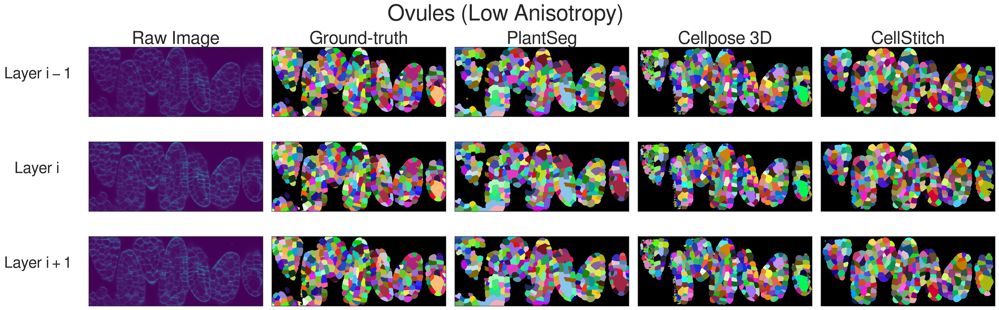

In [14]:
filename = fnames[-1]

# original image
img, mask = imgs[-1], masks[-1]
mask_ct  = np.load(os.path.join(ct_path, filename+'.npy')).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename+'.npy')).astype(np.uint32)
mask_ps = np.load(os.path.join(ps_path, filename+'.npy')).astype(np.uint32)
mask_ps -= mask_ps.min()
                            
fig, axes = disp_adj_slices(img, 
                            mask, 
                            mask_cp, 
                            mask_ps, 
                            mask_ct, 
                            idx=75, 
                            figsize=(25, 8),
                            show_title=True
                           )

fig.suptitle('Ovules (Low Anisotropy)', y=1.03, fontsize=40)

In [ ]:
fig.savefig('../figures/fig5a_cellstitch_example.png', bbox_inches = "tight", dpi=300)

In [32]:
# Load high-anisotropy Ovules images & predictions
ss_filename = fnames[1]
ss_idx = np.arange(0, 388, 2)
img_ss = imgs[1][ss_idx]
mask_ss = masks[1][ss_idx]

mask_ct_ss = np.load(os.path.join(ct_ss_path, ss_filename+'.npy')).astype(np.uint32)
mask_cp_ss = np.load(os.path.join(cp_ss_path, ss_filename+'.npy')).astype(np.uint32)
mask_ps_ss = np.load(os.path.join(ps_ss_path, ss_filename+'.npy')).astype(np.uint32)

Text(0.5, 1.02, 'Ovules (High Anisotropy)')

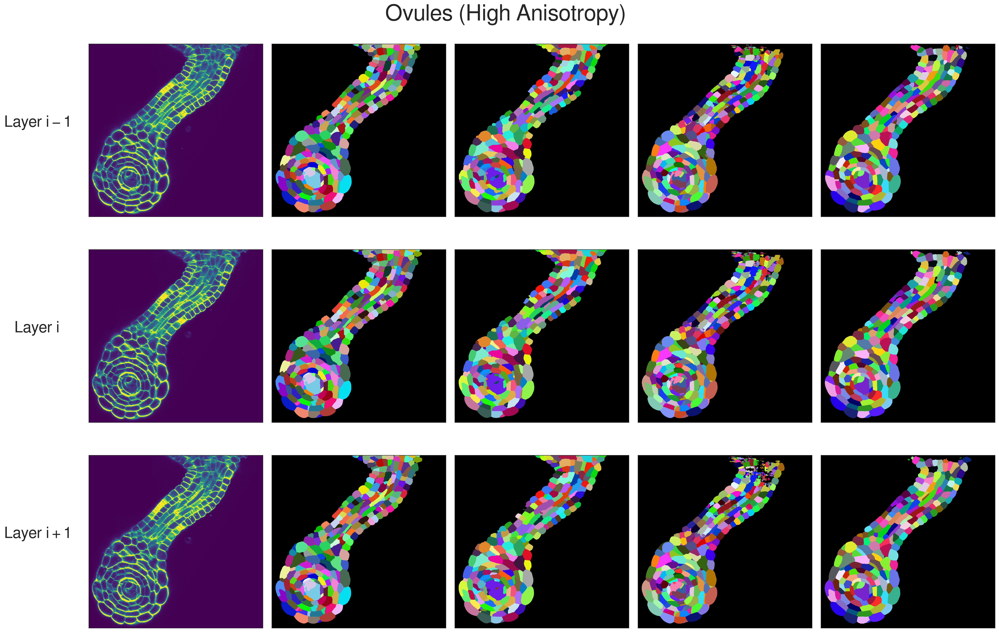

In [36]:
fig, axes = disp_adj_slices(img_ss, 
                            mask_ss, 
                            mask_cp_ss, 
                            mask_ps_ss, 
                            mask_ct_ss, 
                            idx=96)

fig.suptitle('Ovules (High Anisotropy)', y=1.02, fontsize=40)

In [37]:
# Add highlight box
bound = patches.Rectangle((600, 10), 300, 400, linewidth=3, edgecolor='lightyellow', facecolor='none')
for row in range(3):
    for col in range(1, 5):
        bound = patches.Rectangle((600, 10), 300, 400, linewidth=2, edgecolor='lightyellow', facecolor='none')
        axes[row][col].add_patch(bound)

In [40]:
fig.savefig('../figures/fig5b_cellstitch_ss_example.png', bbox_inches = "tight", dpi=300)

Text(0.5, 1.02, 'Ovules (High Anisotropy)')

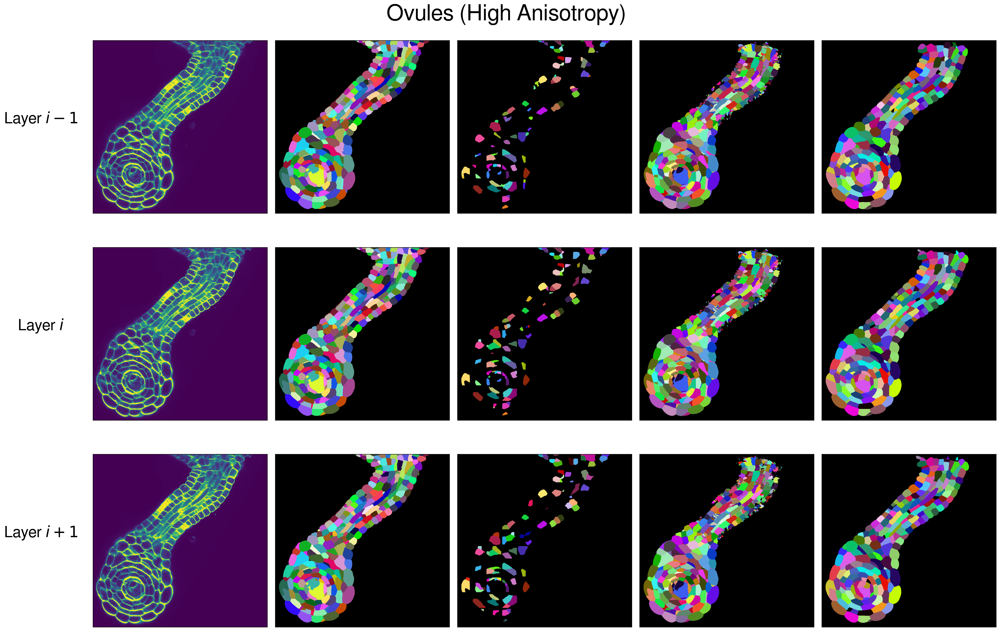

In [ ]:
fig, axes = disp_adj_slices(img_ss, 
                            mask_ss, 
                            mask_cp_ss, 
                            mask_ps_ss, 
                            mask_ct_ss, 
                            idx=96)

fig.suptitle('Ovules (High Anisotropy)', y=1.02, fontsize=40)

In [46]:
# Add highlight box
bound = patches.Rectangle((600, 10), 300, 400, linewidth=3, edgecolor='lightyellow', facecolor='none')
for row in range(3):
    for col in range(1, 4):
        bound = patches.Rectangle((600, 10), 300, 400, linewidth=2, edgecolor='lightyellow', facecolor='none')
        axes[row][col].add_patch(bound)
        
fig.savefig('figures/cellstitch_ss_example.png', bbox_inches = "tight", dpi=300)

#### Figure 6. Visualization of CellStitch vs. Cellpose2D

In [6]:
import tifffile
import matplotlib.patches as patches

In [29]:
def _mask_to_rgb(mask):
    n_lbls = evaluation.get_num_cells(mask)
    colors = np.random.random((n_lbls, 3))
    rgb = label2rgb(mask, colors=colors, bg_label=0)
    return rgb


def disp_adj_slices(img, 
                    mask, 
                    cp2d_pred,
                    ct_pred, 
                    idx,
                    show_title=False,
                    figsize=(20, 16)
                   ):
    """
    Juxtapose example slice i-1, i, i+1 between Ground-truth, CellStitch & competing method results
    """
    assert mask.shape == cp2d_pred.shape == ct_pred.shape, 'Inconsistent shapes'
    assert 0 < idx < mask.shape[0]-1, 'Invalid subsampling idx'
    
    imgi = img[idx-1:idx+2]
    maski, cp2d_predi, ct_predi = mask[idx-1:idx+2], cp2d_pred[idx-1:idx+2], ct_pred[idx-1:idx+2]
    maski, cp2d_predi, ct_predi = _mask_to_rgb(maski), _mask_to_rgb(cp2d_predi),_mask_to_rgb(ct_predi)

    fig, axes = plt.subplots(3, 4, figsize=figsize, dpi=300)
    for row in range(3):        
        axes[row, 0].imshow(imgi[row], cmap='viridis')
        axes[row, 0].set_xticks([])
        axes[row, 0].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 0].set_title('Raw Image', fontsize=32)        
        
        axes[row, 1].imshow(maski[row])
        axes[row, 1].set_xticks([])
        axes[row, 1].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 1].set_title('Ground-truth', fontsize=32)
            
        axes[row, 2].imshow(cp2d_predi[row])
        axes[row, 2].set_xticks([])
        axes[row, 2].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 2].set_title('Cellpose 2D', fontsize=32)
   
        axes[row, 3].imshow(ct_predi[row])
        axes[row, 3].set_xticks([])
        axes[row, 3].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 3].set_title('CellStitch', fontsize=32) 
            
    row_lbls = [r'Layer $i-1$', r'Layer $i$', r'Layer $i+1$']
    for ax, row in zip(axes[:,0], row_lbls):
        ax.set_ylabel(row, rotation=0, size=28)
        ax.yaxis.set_label_coords(-0.3, 0.5)
            
    fig.tight_layout()
    return fig, axes

In [9]:
%ls ../data/ovules/test

N_294_final_crop_ds2.h5  N_511_final_crop_ds2.h5  N_593_final_crop_ds2.h5
N_435_final_crop_ds2.h5  N_522_final_crop_ds2.h5
N_441_final_crop_ds2.h5  N_590_final_crop_ds2.h5


In [48]:
fname = 'N_511_final_crop_ds2'
res_path = '../results/ovules/'

h5_file = h5py.File('../data/ovules/test/{}.h5'.format(fname))
img = h5_file['raw'][:]
mask = h5_file['label'][:]

cp2d_pred = np.load(os.path.join(res_path, 'cellpose2d', fname+'.npy')).astype(np.int64)
ct_pred = np.load(os.path.join(res_path, 'cellstitch', fname+'.npy')).astype(np.int64)

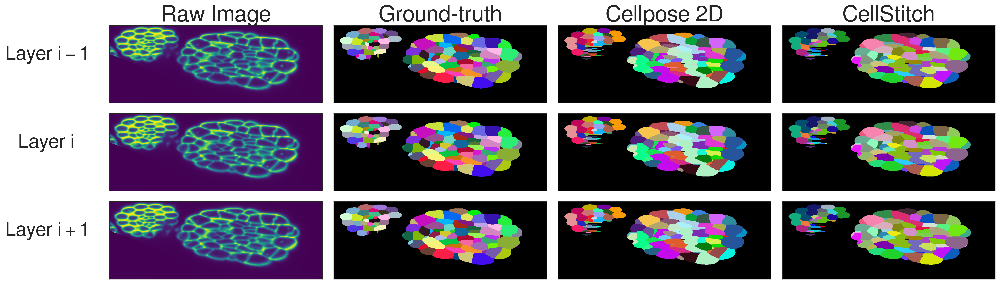

In [53]:
fig, axes = disp_adj_slices(img.transpose((1,0,2)),
                            mask.transpose((1,0,2)),
                            cp2d_pred.transpose((1,0,2)),
                            ct_pred.transpose((1,0,2)),
                            idx=150,
                            show_title=True,
                            figsize=(20, 6))

# Add highlight box
bound = patches.Rectangle((160, 450), 100, 100, linewidth=3, edgecolor='lightyellow', facecolor='none')
for row in range(3):
    for col in range(1, 4):
        bound = patches.Rectangle((160, 450), 100, 100, linewidth=2, edgecolor='lightyellow', facecolor='none')
        axes[row][col].add_patch(bound)

plt.show()


#### Figure 7. Visualization of 3D Arabidopsis Atlas results

In [29]:
import tifffile
import matplotlib.patches as patches

In [64]:
def _mask_to_rgb(mask):
    n_lbls = evaluation.get_num_cells(mask)
    colors = np.random.random((n_lbls, 3))
    rgb = label2rgb(mask, colors=colors, bg_label=0)
    return rgb

def disp_adj_slices(img, 
                    mask, 
                    cp2d_pred,
                    cp_pred, 
                    # ps_pred,
                    ct_pred, 
                    idx,
                    show_title=False,
                    figsize=(28, 16)
                   ):
    """
    Juxtapose example slice i-1, i, i+1 between Ground-truth, CellStitch & competing method results
    """
    assert img.shape == mask.shape == cp_pred.shape == ct_pred.shape, 'Inconsistent shapes'
    assert 0 < idx < img.shape[0]-1, 'Invalid subsampling idx'
    
    imgi, maski = img[idx-1:idx+2], mask[idx-1:idx+2]
    cp2d_predi, cp_predi, ct_predi = cp2d_pred[idx-1:idx+2], cp_pred[idx-1:idx+2], ct_pred[idx-1:idx+2]
    maski, cp2d_predi, cp_predi, ct_predi = _mask_to_rgb(maski), _mask_to_rgb(cp2d_predi), _mask_to_rgb(cp_predi), _mask_to_rgb(ct_predi)
    
    # cp_predi, ps_predi, ct_predi = cp_pred[idx-1:idx+2], ps_pred[idx-1:idx+2], ct_pred[idx-1:idx+2]
    # maski, cp_predi, ps_predi, ct_predi = _mask_to_rgb(maski), _mask_to_rgb(cp_predi), _mask_to_rgb(ps_predi), _mask_to_rgb(ct_predi)
    
    fig, axes = plt.subplots(3, 5, figsize=figsize, dpi=300)
    for row in range(3):
        axes[row, 0].imshow(imgi[row], cmap='viridis')
        axes[row, 0].set_xticks([])
        axes[row, 0].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 0].set_title('Raw Image', fontsize=32)
        
        axes[row, 1].imshow(maski[row])
        axes[row, 1].set_xticks([])
        axes[row, 1].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 1].set_title('Ground-truth', fontsize=32)
            
        axes[row, 2].imshow(cp2d_predi[row])
        axes[row, 2].set_xticks([])
        axes[row, 2].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 2].set_title('Cellpose 2D', fontsize=32)
   
        axes[row, 3].imshow(cp_predi[row])
        axes[row, 3].set_xticks([])
        axes[row, 3].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 3].set_title('Cellpose 3D', fontsize=32) 
            
        axes[row, 4].imshow(ct_predi[row])
        axes[row, 4].set_xticks([])
        axes[row, 4].set_yticks([])
        
        if row == 0 and show_title:
            axes[row, 4].set_title('CellStitch', fontsize=32)  
            
#       If we have PlantSeg output for plant atlas dataset
#         axes[row, 3].imshow(ps_predi[row])
#         axes[row, 3].set_xticks([])
#         axes[row, 3].set_yticks([])
        
#         if row == 0 and show_title:
#             axes[row, 3].set_title('PlantSeg', fontsize=32)
            
#         axes[row, 4].imshow(ct_predi[row])
#         axes[row, 4].set_xticks([])
#         axes[row, 4].set_yticks([])
        
#         if row == 0 and show_title:
#             axes[row, 4].set_title('CellStitch', fontsize=32)  
         
    row_lbls = [r'Layer $i-1$', r'Layer $i$', r'Layer $i+1$']
    for ax, row in zip(axes[:,0], row_lbls):
        ax.set_ylabel(row, rotation=0, size=28)
        ax.yaxis.set_label_coords(-0.3, 0.5)
            
    fig.tight_layout()
    return fig, axes

##### (1). Anther

**TODO: recover patched images**

In [90]:
anther_img = np.zeros((20, 224, 224), dtype=np.float64)
anther_msk = np.zeros((20, 224, 224), dtype=np.int32)

path = '../../datasets/exploratory/val_slice/'
fnames = [
    f for f in sorted(os.listdir(path))
    if f[-3:] == 'tif' and 'Anther_37' in f and 'flows' not in f and 'masks' not in f
]

for i, f in enumerate(fnames):
    anther_img[i] = tifffile.imread(os.path.join(path, f))
    anther_msk[i] = tifffile.imread(os.path.join(path, f.split('.')[0]+'_masks.tif'))
    
tifffile.imsave('../../datasets/exploratory/val/Anther_37.tif', anther_img)
tifffile.imsave('../../datasets/exploratory/val/Anther_37_mask.tif', anther_msk)

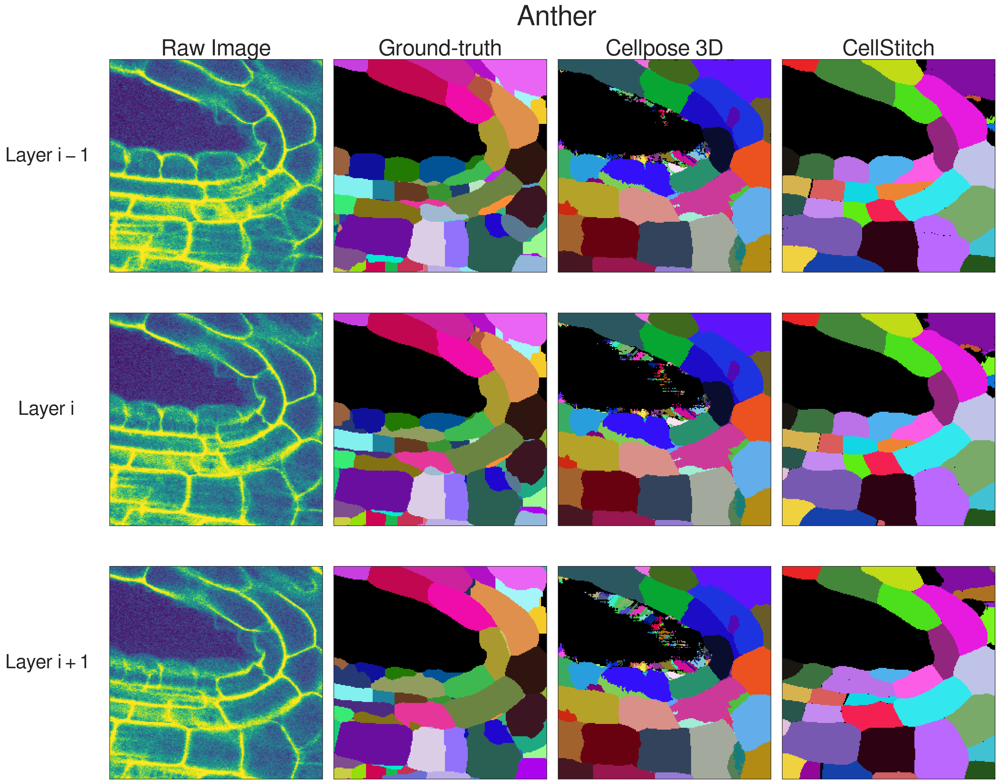

In [43]:
data_type = 'Anther'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
# ps_path = os.path.join(res_path, 'plantseg/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[17]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)
mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
# mask_ps = np.load(os.path.join(ps_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

fig, axes = disp_adj_slices(img, 
                            mask, 
                            mask_cp, 
                            mask_ct, 
                            idx=1, 
                            show_title=True,
                            figsize=(20, 16),
                            )
fig.suptitle('Anther', x=0.55, y=1.01, fontsize=40)
plt.show()

In [44]:
fig.savefig('../figures/cellstitch_anther.png', bbox_inches='tight', dpi=300)

XZ & YZ directions:

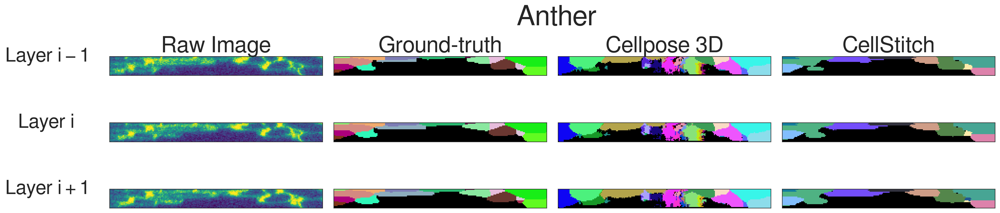

In [45]:
fig, axes = disp_adj_slices(img.transpose((1,0,2)), 
                            mask.transpose((1,0,2)), 
                            mask_cp.transpose((1,0,2)), 
                            mask_ct.transpose((1,0,2)), 
                            idx=112, 
                            show_title=True,
                            figsize=(20, 5),
                            )
fig.suptitle('Anther', x=0.55, y=1.01, fontsize=40)
plt.show()

In [46]:
fig.savefig('../figures/cellstitch_anther_yz.png', bbox_inches='tight', dpi=300)

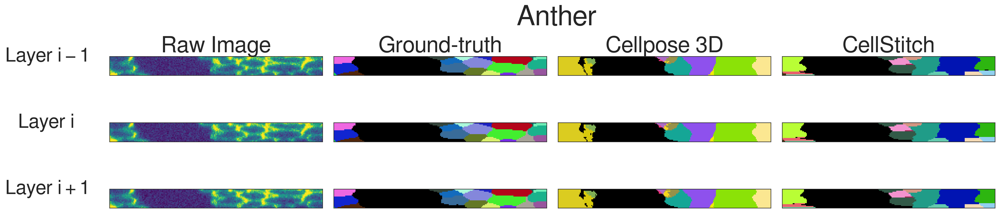

In [52]:
fig, axes = disp_adj_slices(img.transpose((2,0,1)), 
                            mask.transpose((2,0,1)), 
                            mask_cp.transpose((2,0,1)), 
                            mask_ct.transpose((2,0,1)), 
                            idx=45,
                            show_title=True,
                            figsize=(20, 5),
                            )
fig.suptitle('Anther', x=0.55, y=1.01, fontsize=40)
plt.show()

In [53]:
fig.savefig('../figures/cellstitch_anther_xz.png', bbox_inches='tight', dpi=300)

##### (2). Filament

In [143]:
filament_img = np.zeros((20, 224, 224), dtype=np.float64)
filament_msk = np.zeros((20, 224, 224), dtype=np.int32)

path = '../../datasets/exploratory/val_slice/'
fnames = [
    f for f in sorted(os.listdir(path))
    if f[-3:] == 'tif' and 'Filament_32' in f and 'flows' not in f and 'masks' not in f
]

for i, f in enumerate(fnames):
    filament_img[i] = tifffile.imread(os.path.join(path, f))
    filament_msk[i] = tifffile.imread(os.path.join(path, f.split('.')[0]+'_masks.tif'))

tifffile.imsave('../../datasets/exploratory/val/Filament_32.tif', filament_img)
tifffile.imsave('../../datasets/exploratory/val/Filament_32_mask.tif', filament_msk)

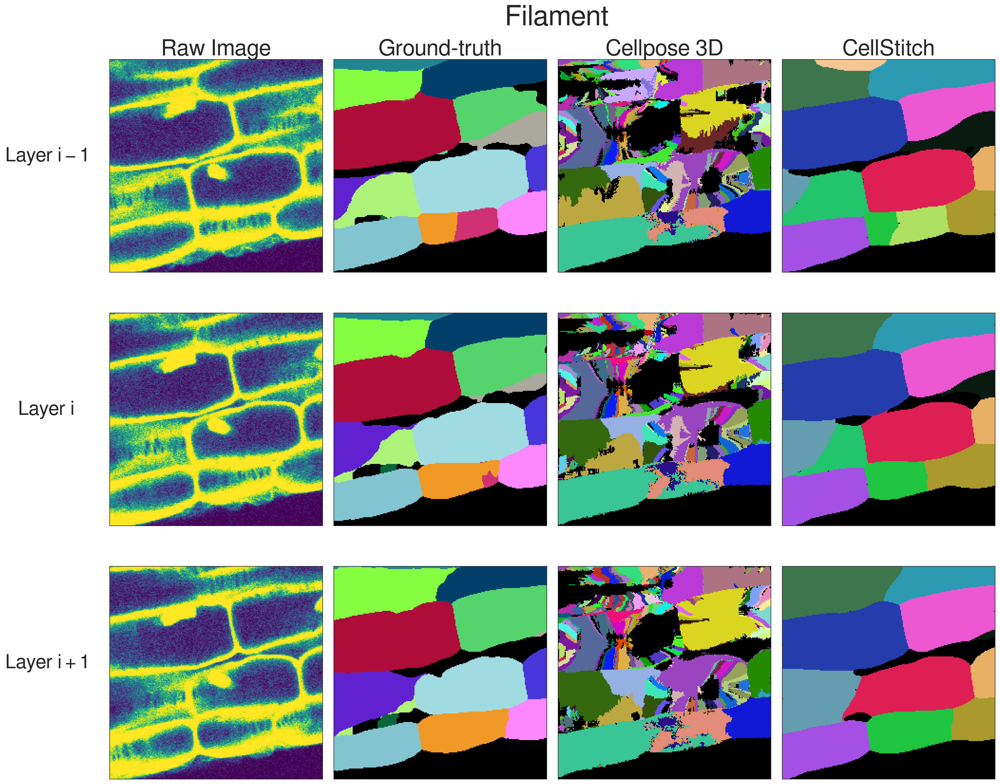

In [54]:
data_type = 'Filament'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[12]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)

mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

fig, axes = disp_adj_slices(img, 
                            mask, 
                            mask_cp, 
                            mask_ct, 
                            idx=10, 
                            show_title=True,
                            figsize=(20, 16),
                            )
fig.suptitle(data_type, x=0.55, y=1.01, fontsize=40)
plt.show()


In [55]:
fig.savefig('../figures/cellstitch_filament.png', dpi=300, bbox_inches='tight')

XZ & YZ directions:

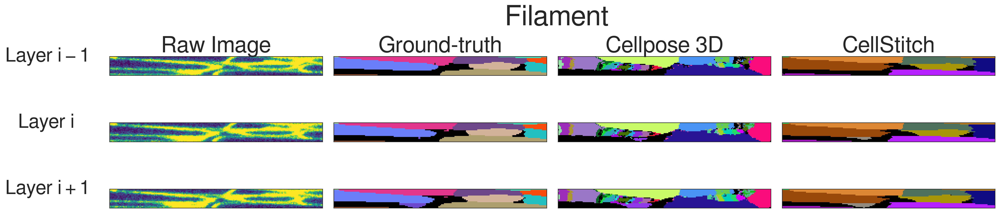

In [58]:
fig, axes = disp_adj_slices(img.transpose((1,0,2)), 
                            mask.transpose((1,0,2)), 
                            mask_cp.transpose((1,0,2)), 
                            mask_ct.transpose((1,0,2)), 
                            idx=100, 
                            show_title=True,
                            figsize=(20, 5),
                            )
fig.suptitle(data_type, x=0.55, y=1.01, fontsize=40)
plt.show()

In [59]:
fig.savefig('../figures/cellstitch_filament_yz.png', dpi=300, bbox_inches='tight')

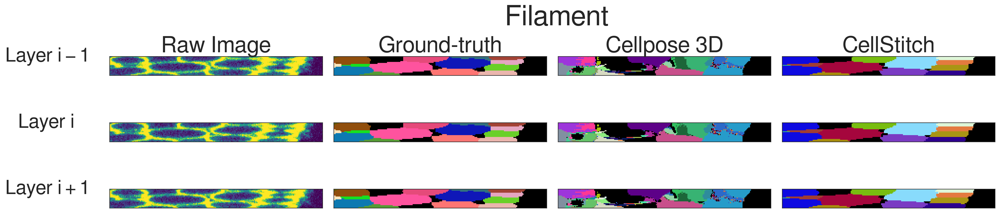

In [62]:
fig, axes = disp_adj_slices(img.transpose((2,0,1)), 
                            mask.transpose((2,0,1)), 
                            mask_cp.transpose((2,0,1)), 
                            mask_ct.transpose((2,0,1)), 
                            idx=100, 
                            show_title=True,
                            figsize=(20, 5),
                            )
fig.suptitle(data_type, x=0.55, y=1.01, fontsize=40)
plt.show()

In [63]:
fig.savefig('../figures/cellstitch_filament_xz.png', dpi=300, bbox_inches='tight')

##### (3). Leaf

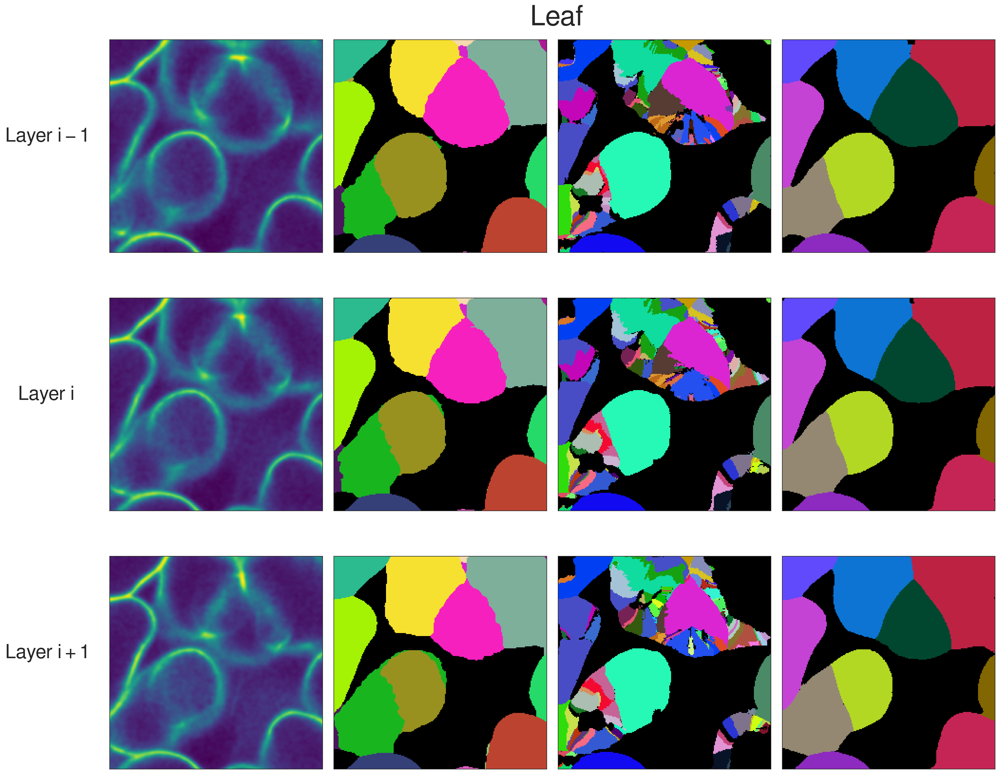

In [65]:
data_type = 'Leaf'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[2]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)

mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

fig, axes = disp_adj_slices(img, 
                            mask, 
                            mask_cp, 
                            mask_ct, 
                            idx=10, 
                            figsize=(20, 16),
                            )
fig.suptitle(data_type, x=0.55, y=1, fontsize=40)
plt.show()

In [66]:
fig.savefig('../figures/cellstitch_leaf.png', dpi=300, bbox_inches='tight')

##### (4). Pedicel

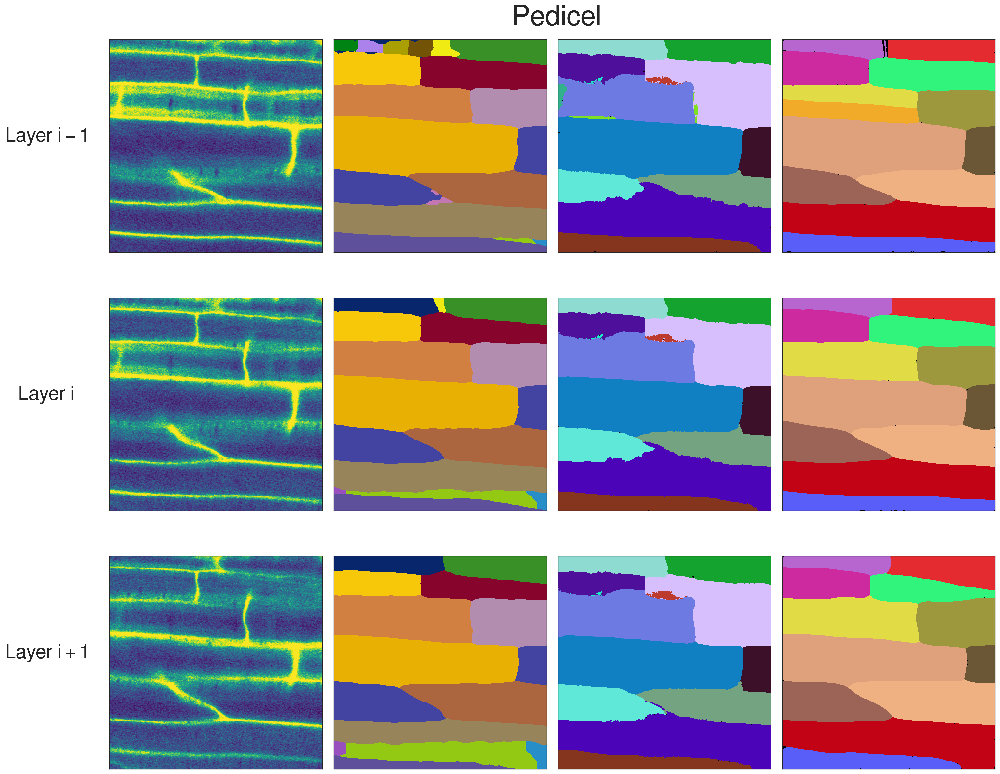

In [71]:
data_type = 'Pedicel'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[22]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)

mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

fig, axes = disp_adj_slices(img, 
                            mask, 
                            mask_cp, 
                            mask_ct, 
                            idx=10, 
                            figsize=(20, 16),
                            )
fig.suptitle(data_type, x=0.55, y=1, fontsize=40)
plt.show()

In [72]:
fig.savefig('../figures/cellstitch_pedicel.png', dpi=300, bbox_inches='tight')

##### (5). Sepal

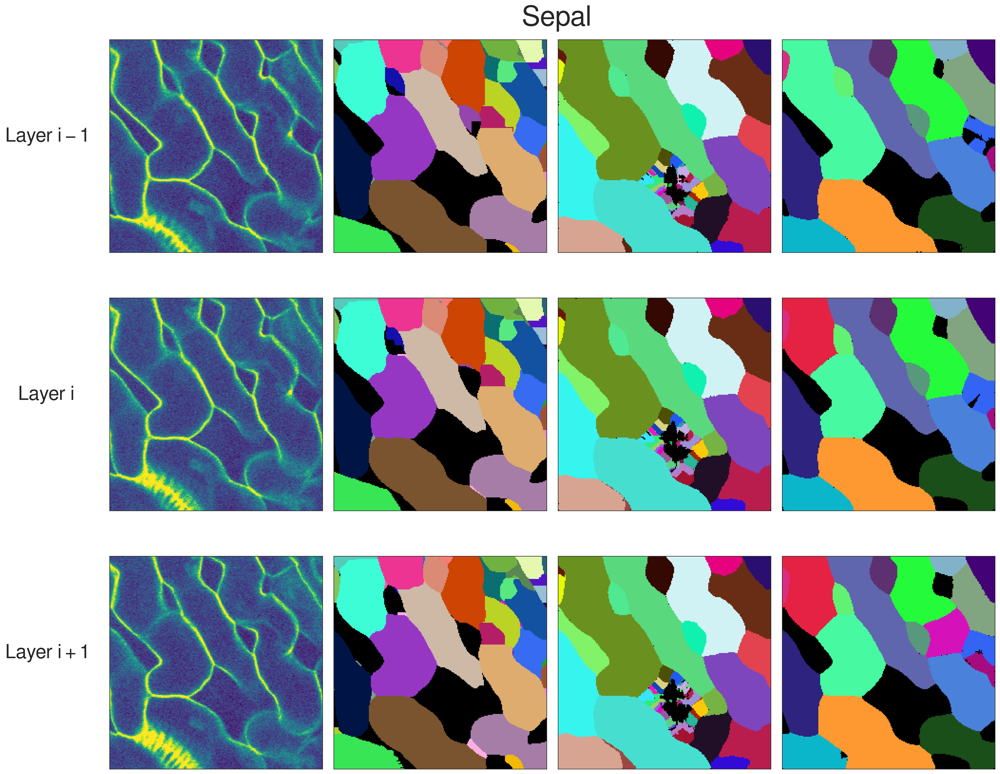

In [11]:
data_type = 'Sepal'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[3]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)

mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

fig, axes = disp_adj_slices(img, 
                            mask, 
                            mask_cp, 
                            mask_ct, 
                            idx=10, 
                            figsize=(20, 16),
                            )
fig.suptitle(data_type, x=0.55, y=1, fontsize=40)
plt.show()

In [77]:
fig.savefig('../figures/cellstitch_sepal.png', dpi=300, bbox_inches='tight')

##### (6). Valve

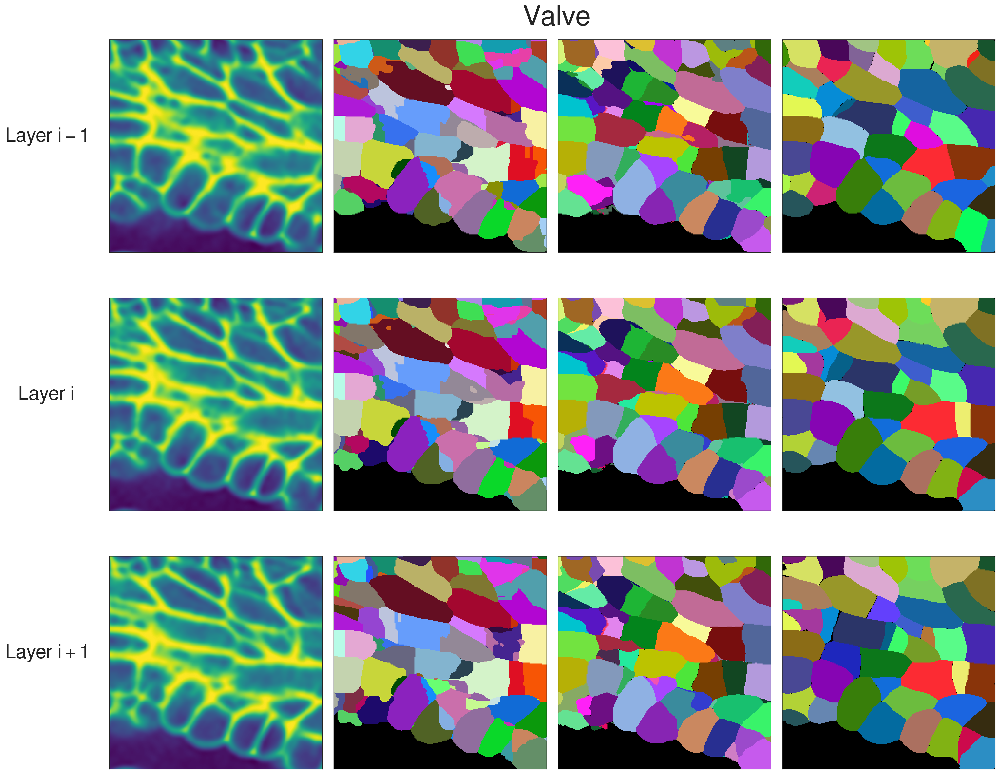

In [83]:
data_type = 'Valve'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[6]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)

mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

fig, axes = disp_adj_slices(img, 
                            mask, 
                            mask_cp, 
                            mask_ct, 
                            idx=10, 
                            figsize=(20, 16),
                            )
fig.suptitle(data_type, x=0.55, y=1, fontsize=40)
plt.show()


In [84]:
fig.savefig('../figures/cellstitch_valve.png', dpi=300, bbox_inches='tight')

Try mayavi visualization:

In [53]:
from matplotlib import colors
from mayavi import mlab

In [160]:
def disp_3d_slices(
    msk,
    size=(2000, 1600),
    savefig=False,
    outdir=None,
    fname=None,
    dpi=300
):
    """3D slice visualization of given image/mask with [Y, X, Z] dimension order"""
    
    mlab.figure(bgcolor=colors.to_rgb("black"), size=size)

    height, width, depth = msk.shape
    axes_extent = [0, height, 0, width, 0, depth]
    xlabel, ylabel, zlabel = 'X', 'Y', 'Z'
 
    cmap = 'viridis' if msk.dtype.kind == 'f' else 'Paired'
    res=mlab.volume_slice(msk, colormap=cmap, plane_orientation='z_axes', slice_index=10)
    res=mlab.volume_slice(msk, colormap=cmap, plane_orientation='y_axes', slice_index=112)
    res=mlab.volume_slice(msk, colormap=cmap, plane_orientation='x_axes', slice_index=112)

    ax = mlab.axes(line_width=0.5, extent=axes_extent, xlabel=xlabel, ylabel=ylabel, zlabel=zlabel)
    ax.axes.font_factor = 0.75
    #mlab.outline()
    mlab.show()
    
    if savefig and (outdir is not None and fname is not None):
        if not os.path.exists(outdir):
            os.makedirs(outdir)
        mlab.savefig(os.path.join(outdir, fname), figure=res, magnification=dpi)
        
    return res

In [112]:
data_type = 'Anther'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[17]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)
mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

img, mask, mask_ct, mask_cp = img.transpose((1,2,0)), mask.transpose((1,2,0)), mask_ct.transpose((1,2,0)), mask_cp.transpose((1,2,0))


In [157]:
disp_3d_slices(img)

Image(value=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x07\xd0\x00\x00\x06@\x08\x02\x00\x00\x00\xaeKN\xd9\x…

In [158]:
disp_3d_slices(mask_cp)

Image(value=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x07\xd0\x00\x00\x06@\x08\x02\x00\x00\x00\xaeKN\xd9\x…

In [159]:
disp_3d_slices(mask_ct, size=(2000, 1600))

Image(value=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x07\xd0\x00\x00\x06@\x08\x02\x00\x00\x00\xaeKN\xd9\x…

In [161]:
data_type = 'Filament'

img_path = '../../datasets/exploratory/val/'
mask_path = '../../datasets/exploratory/val/'

# raw & subsampled images
res_path = '../results/{}/'.format(data_type)
ct_path = os.path.join(res_path, 'cellstitch/')
cp_path = os.path.join(res_path, 'cellpose3d/')

filenames = [
    f for f in sorted(os.listdir(ct_path))
    if f[-3:] == 'npy' and 'interp' not in f
]

filename = filenames[12]
filename_img = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '.tif'
filename_msk = filename.partition('_')[0] + '_' + str(int(filename.split('_')[-1].split('.')[0])-50) + '_mask.tif'

img = tifffile.imread(os.path.join(img_path, filename_img))
mask = tifffile.imread(os.path.join(mask_path, filename_msk)).astype(np.uint32)
mask_ct  = np.load(os.path.join(ct_path, filename)).astype(np.uint32)
mask_cp = np.load(os.path.join(cp_path, filename)).astype(np.uint32)

img, mask, mask_ct, mask_cp = img.transpose((1,2,0)), mask.transpose((1,2,0)), mask_ct.transpose((1,2,0)), mask_cp.transpose((1,2,0))


In [163]:
disp_3d_slices(img)

Image(value=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x07\xd0\x00\x00\x06@\x08\x02\x00\x00\x00\xaeKN\xd9\x…

In [164]:
disp_3d_slices(mask)

Image(value=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x07\xd0\x00\x00\x06@\x08\x02\x00\x00\x00\xaeKN\xd9\x…

In [165]:
disp_3d_slices(mask_cp)

Image(value=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x07\xd0\x00\x00\x06@\x08\x02\x00\x00\x00\xaeKN\xd9\x…

In [166]:
disp_3d_slices(mask_ct)

Image(value=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x07\xd0\x00\x00\x06@\x08\x02\x00\x00\x00\xaeKN\xd9\x…

#### Suppl. Table 3: Comparison w/ Pretrained Cellpose2D

In [36]:
import torch

In [20]:
atas_path = '../data/ATAS/'
atas_test_path = '../results/ATAS/cellpose2d/'  # Load ATAS filenames in test set 

# Load imgs & masks in the test set
fnames = [
    f.rpartition('.')[0]
    for f in sorted(os.listdir(atas_test_path))
    if f[-3:] == 'npy'
]

imgs = [
    np.load(os.path.join(atas_path, 'raw', f+'.npy'))
    for f in fnames
]

masks = [
    np.load(os.path.join(atas_path, 'labels', f+'.npy'))
    for f in fnames
]

assert len(imgs) == len(masks) == len(fnames), "Unequal # imgs & annotated masks in ATAS test set"
del atas_test_path


In [21]:
# Load pretrained model
cp_model = cp_models.Cellpose(gpu=True, model_type='cyto2')

In [29]:
tmp_pred = cp_utils.stitch3D(
    cp_model.eval(list(imgs[0]), do_3D=False, flow_threshold=1, channels=[0, 0])[0]
)

In [37]:
out_path = '../results/ATAS/cellpose2d_pretrained'

for fname, img in zip(fnames, imgs):
    print('Predicting img {}...'.format(fname))
    pred = np.asarray(
        cp_utils.stitch3D(
            cp_model.eval(list(img), do_3D=False, flow_threshold=1, channels=[0,0])[0]
        )
    )
    
    np.save(os.path.join(out_path, fname+'.npy'), pred)
    torch.cuda.empty_cache()
    
del pred, out_path

Predicting img 0hrs_plant13_trim-acylYFP...
Predicting img 0hrs_plant18_trim-acylYFP...
Predicting img 0hrs_plant2_trim-acylYFP...
Predicting img 12hrs_plant18_trim-acylYFP...
Predicting img 12hrs_plant2_trim-acylYFP...
Predicting img 20hrs_plant13_trim-acylYFP...
Predicting img 20hrs_plant2_trim-acylYFP...
Predicting img 24hrs_plant13_trim-acylYFP...
Predicting img 24hrs_plant15_trim-acylYFP...
Predicting img 28hrs_plant1_trim-acylYFP...
Predicting img 32hrs_plant13_trim-acylYFP...
Predicting img 36hrs_plant15_trim-acylYFP...
Predicting img 36hrs_plant2_trim-acylYFP...
Predicting img 40hrs_plant13_trim-acylYFP...
Predicting img 40hrs_plant1_trim-acylYFP...
Predicting img 40hrs_plant2_trim-acylYFP...
Predicting img 44hrs_plant18_trim-acylYFP...
Predicting img 44hrs_plant2_trim-acylYFP...
Predicting img 44hrs_plant4_trim-acylYFP...
Predicting img 48hrs_plant15_trim-acylYFP...
Predicting img 48hrs_plant4_trim-acylYFP...
Predicting img 4hrs_plant15_trim-acylYFP...
Predicting img 52hrs_pla

In [38]:
# Evaluate metrics
res_path = '../results/ATAS/cellpose2d_pretrained'
metrics = np.zeros((len(fnames), 7))

for i, fname in enumerate(fnames):
    print('Calculating metrics for {}...'.format(fname))
    y_pred = np.load(os.path.join(res_path, fname+'.npy')).astype(np.int64)
    y_true = masks[i]
    
    assert y_pred.shape == y_true.shape, "Inconsistent shapes btw ground-truth & predictions"
    
    ap25 = evaluation.average_precision(y_true, y_pred, 0.25)[0]
    ap75 = evaluation.average_precision(y_true, y_pred, 0.75)[0]
    ap50, tp, fp, fn = evaluation.average_precision(y_true, y_pred, 0.5)
    mAP = np.mean([ap25, ap50, ap75])
    prec, recall, f1 = tp/(tp+fp), tp/(tp+fn), tp/(tp+0.5*(fp+fn))
    
    metrics[i] = [prec, recall, f1, ap25, ap50, ap75, mAP]
    gc.collect()
    
del y_true, y_pred, ap25, ap50, ap75, tp, fp, fn, prec, recall, f1

Calculating metrics for 0hrs_plant13_trim-acylYFP...
Calculating metrics for 0hrs_plant18_trim-acylYFP...
Calculating metrics for 0hrs_plant2_trim-acylYFP...
Calculating metrics for 12hrs_plant18_trim-acylYFP...
Calculating metrics for 12hrs_plant2_trim-acylYFP...
Calculating metrics for 20hrs_plant13_trim-acylYFP...
Calculating metrics for 20hrs_plant2_trim-acylYFP...
Calculating metrics for 24hrs_plant13_trim-acylYFP...
Calculating metrics for 24hrs_plant15_trim-acylYFP...
Calculating metrics for 28hrs_plant1_trim-acylYFP...
Calculating metrics for 32hrs_plant13_trim-acylYFP...
Calculating metrics for 36hrs_plant15_trim-acylYFP...
Calculating metrics for 36hrs_plant2_trim-acylYFP...
Calculating metrics for 40hrs_plant13_trim-acylYFP...
Calculating metrics for 40hrs_plant1_trim-acylYFP...
Calculating metrics for 40hrs_plant2_trim-acylYFP...
Calculating metrics for 44hrs_plant18_trim-acylYFP...
Calculating metrics for 44hrs_plant2_trim-acylYFP...
Calculating metrics for 44hrs_plant4_tr

In [39]:
metrics_df = pd.DataFrame(metrics, index=fnames, columns=['prec', 'recall', 'f1', 'AP25', 'AP50', 'AP75', 'mAP'])
metrics_df.head()

,prec,recall,f1,AP25,AP50,AP75,mAP
0hrs_plant13_trim-acylYFP,0.718310,0.485714,0.579545,0.929600,0.408000,0.225600,0.521067
0hrs_plant18_trim-acylYFP,0.649007,0.411765,0.503856,0.852234,0.336770,0.164948,0.451317
0hrs_plant2_trim-acylYFP,0.624633,0.386570,0.477578,0.842415,0.313697,0.172312,0.442808
12hrs_plant18_trim-acylYFP,0.653125,0.411823,0.505136,0.853678,0.337914,0.156831,0.449475
12hrs_plant2_trim-acylYFP,0.681905,0.460154,0.549501,0.914286,0.378836,0.186243,0.493122


In [40]:
metrics_df.mean(0)

prec      0.626772
recall    0.419229
f1        0.501561
AP25      0.829696
AP50      0.335889
AP75      0.162746
mAP       0.442777
dtype: float64

In [41]:
metrics_df.std(0)

prec      0.045436
recall    0.047478
f1        0.044724
AP25      0.055215
AP50      0.040179
AP75      0.036487
mAP       0.036346
dtype: float64

In [42]:
metrics_df.to_csv('../results/ATAS/cellpose2d_pretrained.csv', index=True)